In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
import torchvision
from torchvision import transforms
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import pylab
import pandas as pd
from sklearn.manifold import TSNE
from sklearn import manifold
import seaborn as sns
import time
from sklearn.datasets import make_swiss_roll

In [2]:
pretrained_model = "data/lenet_mnist_model.pth"
if torch.cuda.is_available():
    device = torch.device("cuda")
else:
    device = torch.device("cpu")

In [3]:
class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(1, 10, kernel_size=5)
        self.conv2 = nn.Conv2d(10, 20, kernel_size=5)
        self.conv2_drop = nn.Dropout2d()
        self.fc1 = nn.Linear(320, 50)
        self.fc2 = nn.Linear(50, 10)

    def forward(self, x):
        x = F.relu(F.max_pool2d(self.conv1(x), 2))
        x = F.relu(F.max_pool2d(self.conv2_drop(self.conv2(x)), 2))
        x = x.view(-1, 320)
        x = F.relu(self.fc1(x))
        x = F.dropout(x, training=self.training)
        return x

In [4]:
model = Net().to(device)
model.load_state_dict(torch.load(pretrained_model))
model.eval()

Net(
  (conv1): Conv2d(1, 10, kernel_size=(5, 5), stride=(1, 1))
  (conv2): Conv2d(10, 20, kernel_size=(5, 5), stride=(1, 1))
  (conv2_drop): Dropout2d(p=0.5, inplace=False)
  (fc1): Linear(in_features=320, out_features=50, bias=True)
  (fc2): Linear(in_features=50, out_features=10, bias=True)
)

In [5]:
test_loader = torch.utils.data.DataLoader(
    torchvision.datasets.MNIST('data', train=True, download=True, transform=transforms.Compose([
        transforms.ToTensor(),
            ])),
        batch_size=1, shuffle=False)

len(test_loader)

60000

In [6]:
for data, target in test_loader:
    data, target = data.to(device), target.to(device)
    output = model(data)
    print(output.shape)
    print(data.size())
    break

torch.Size([1, 50])
torch.Size([1, 1, 28, 28])


In [7]:
outputs = np.empty((len(test_loader),50))
x = 0
for data, target in test_loader:
    data, target = data.to(device), target.to(device)
    output = model(data)
    outputs[x] = output.squeeze().tolist()
    x += 1
print(outputs.shape)
print(x)
    

(60000, 50)
60000


In [8]:
outputs

array([[0.20884892, 0.        , 0.95287186, ..., 0.        , 0.        ,
        0.02699973],
       [0.        , 0.        , 1.45453119, ..., 0.        , 1.13831818,
        1.83717346],
       [1.016734  , 1.20026672, 0.        , ..., 0.        , 0.7739591 ,
        0.        ],
       ...,
       [2.0069375 , 0.        , 1.06237459, ..., 0.        , 0.76820368,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 1.40914583,
        0.        ],
       [1.28054893, 0.        , 0.        , ..., 0.        , 0.96439344,
        0.47384971]])

In [9]:
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(outputs)
principalDf =pd.DataFrame(data = principalComponents, columns = ['principalcomponent1',  'principalcomponent2'])

principalDf.head()

,principalcomponent1,principalcomponent2
0,0.059498,-0.758626
1,0.914252,2.356916
2,1.452720,-1.550214
3,-0.141555,1.347809
4,0.174954,-3.737173


In [10]:
label = [label.item() for _, label in test_loader]

In [11]:
label = pd.DataFrame(label)
principalDf = pd.concat([principalDf,label],axis = 1,join='inner', ignore_index=True)
principalDf = principalDf.loc[:,~principalDf.columns.duplicated()]
principalDf.columns = ["principalcomponent1", "principalcomponent2", "label"] 

principalDf.shape

(60000, 3)

In [12]:
principalDf

,principalcomponent1,principalcomponent2,label
0,0.059498,-0.758626,5
1,0.914252,2.356916,0
2,1.452720,-1.550214,4
3,-0.141555,1.347809,1
4,0.174954,-3.737173,9
...,...,...,...
59995,-1.538250,0.642937,8
59996,-3.257289,-0.767738,3
59997,1.072401,-2.770474,5
59998,3.300073,2.283119,6


<Figure size 720x720 with 0 Axes>

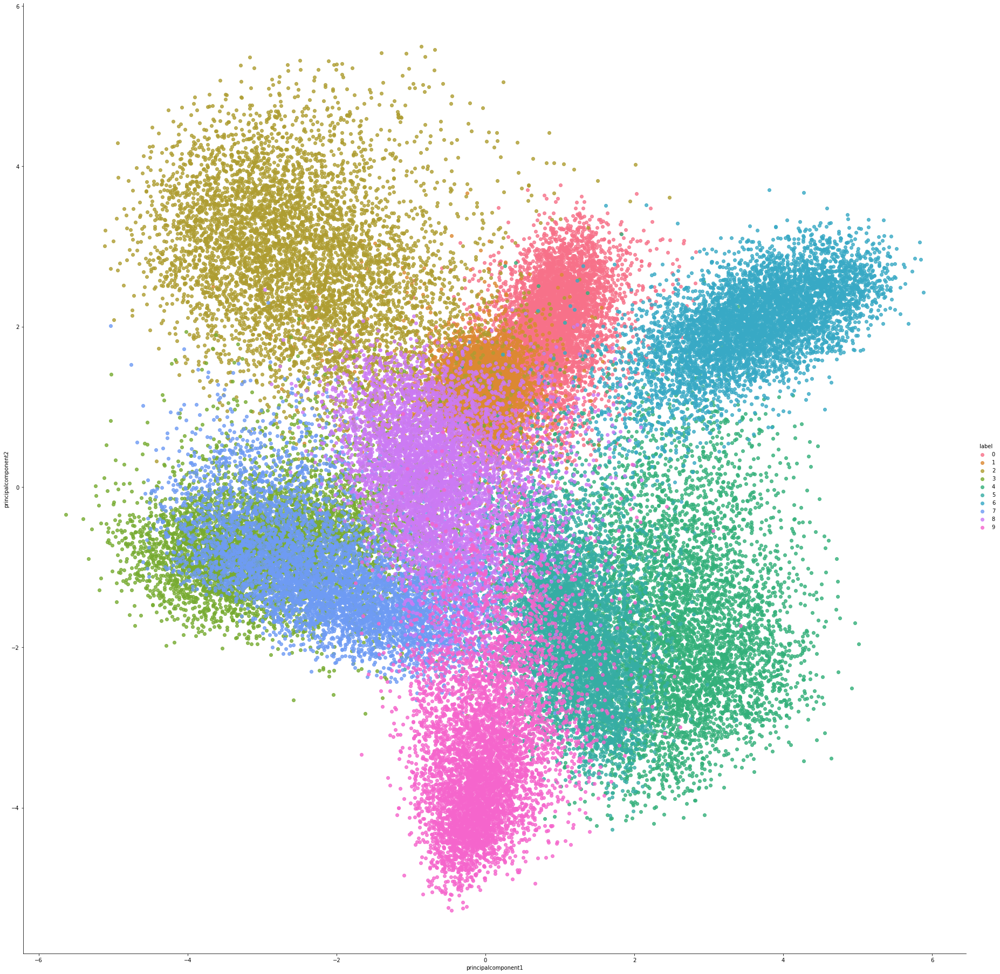

<Figure size 720x720 with 0 Axes>

In [13]:
flatui = ["#9b59b6", "#3498db", "orange"]
sns.set_palette(flatui)
sns.lmplot( x="principalcomponent1", y="principalcomponent2", data=principalDf, fit_reg=False, height=25,
           hue='label', legend=True)

plt.figure(figsize=(10,10))

In [14]:
time_start = time.time()
tsne = TSNE(n_components=3, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(outputs)
print('t-SNE done in {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 60000 samples in 0.007s...
[t-SNE] Computed neighbors for 60000 samples in 124.024s...
[t-SNE] Computed conditional probabilities for sample 1000 / 60000
[t-SNE] Computed conditional probabilities for sample 2000 / 60000
[t-SNE] Computed conditional probabilities for sample 3000 / 60000
[t-SNE] Computed conditional probabilities for sample 4000 / 60000
[t-SNE] Computed conditional probabilities for sample 5000 / 60000
[t-SNE] Computed conditional probabilities for sample 6000 / 60000
[t-SNE] Computed conditional probabilities for sample 7000 / 60000
[t-SNE] Computed conditional probabilities for sample 8000 / 60000
[t-SNE] Computed conditional probabilities for sample 9000 / 60000
[t-SNE] Computed conditional probabilities for sample 10000 / 60000
[t-SNE] Computed conditional probabilities for sample 11000 / 60000
[t-SNE] Computed conditional probabilities for sample 12000 / 60000
[t-SNE] Computed conditional probabilities for 

In [21]:
tsne3_subset = pd.DataFrame(columns=['tsne-3d-one', 'tsne-3d-two', 'tsne-3d-three'])
tsne3_subset['tsne-3d-one'] = tsne_results[:,0]
tsne3_subset['tsne-3d-two'] = tsne_results[:,1]
tsne3_subset['tsne-3d-three'] = tsne_results[:,2]

[[ 0.55935216 -2.0086055  -0.5636408 ]
 [-0.19273193 -2.3480866  -4.6637926 ]
 [-0.7163474  -0.06375811  3.4716797 ]
 ...
 [ 1.1713259  -3.877122    0.392805  ]
 [ 1.995251    2.4332743   0.77431864]
 [-0.56490576 -0.35461605  0.28595033]]


In [16]:
time_start = time.time()
tsne2d = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne2d_results = tsne.fit_transform(outputs)
print('t-SNE done in {} seconds'.format(time.time()-time_start))

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 60000 samples in 0.008s...
[t-SNE] Computed neighbors for 60000 samples in 112.731s...
[t-SNE] Computed conditional probabilities for sample 1000 / 60000
[t-SNE] Computed conditional probabilities for sample 2000 / 60000
[t-SNE] Computed conditional probabilities for sample 3000 / 60000
[t-SNE] Computed conditional probabilities for sample 4000 / 60000
[t-SNE] Computed conditional probabilities for sample 5000 / 60000
[t-SNE] Computed conditional probabilities for sample 6000 / 60000
[t-SNE] Computed conditional probabilities for sample 7000 / 60000
[t-SNE] Computed conditional probabilities for sample 8000 / 60000
[t-SNE] Computed conditional probabilities for sample 9000 / 60000
[t-SNE] Computed conditional probabilities for sample 10000 / 60000
[t-SNE] Computed conditional probabilities for sample 11000 / 60000
[t-SNE] Computed conditional probabilities for sample 12000 / 60000
[t-SNE] Computed conditional probabilities for 

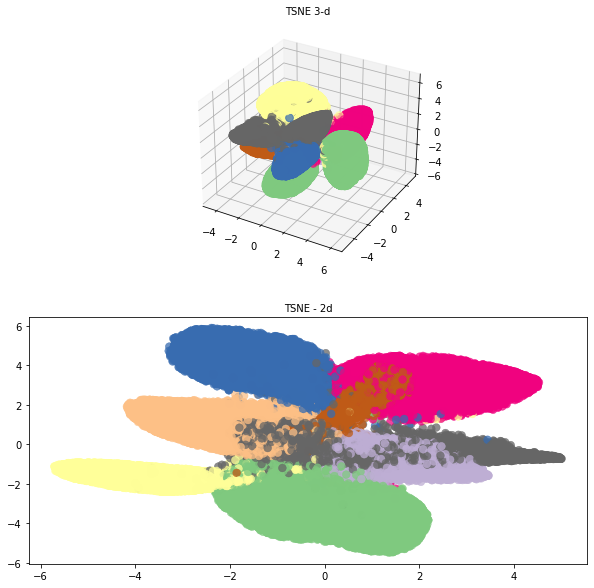

In [17]:
tsne2_subset = pd.DataFrame(columns=['tsne-2d-one', 'tsne-2d-two'])

tsne2_subset['tsne-2d-one'] = tsne2d_results[:,0]
tsne2_subset['tsne-2d-two'] = tsne2d_results[:,1]

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(2, 1, 1,projection='3d')
ax.set_title('TSNE 3-d', fontsize=10)
ax.scatter(tsne_results[:,0],tsne_results[:,1],tsne_results[:,2],c = label,cmap="Accent",s=60)

ax = fig.add_subplot(2, 1, 2) 
ax.set_title('TSNE - 2d', fontsize=10)
ax.scatter(tsne2d_results[:,0],tsne2d_results[:,1],c = label, alpha=.75, linewidths=.5, cmap="Accent",s=60)



<Figure size 1080x1080 with 0 Axes>

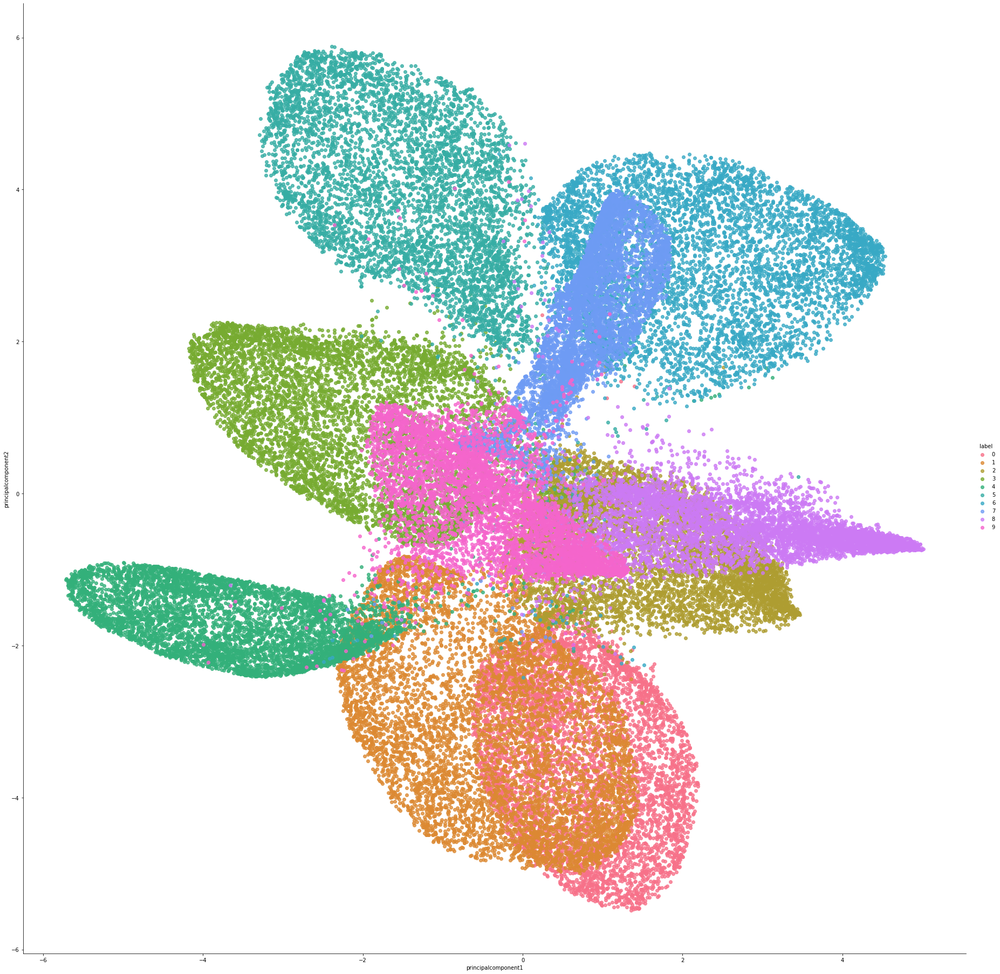

<Figure size 1080x1080 with 0 Axes>

In [18]:

principalDf = pd.concat([tsne2_subset,label],axis = 1,join='inner', ignore_index=True)
principalDf = principalDf.loc[:,~principalDf.columns.duplicated()]
principalDf.columns = ["principalcomponent1", "principalcomponent2", "label"]

flatui = ["#9b59b6", "#3498db", "orange"]
sns.set_palette(flatui)
sns.lmplot( x="principalcomponent1", y="principalcomponent2", data=principalDf, fit_reg=False, height=25,
           hue='label', legend=True)

plt.figure(figsize=(15,15))